In [52]:
from FlowCytometryTools import FCMeasurement, ThresholdGate, PolyGate, IntervalGate
import os
from os.path import join
from pylab import *
import pandas as pd
import numpy as np
import itertools
import altair as alt
from altair_saver import save as alt_save
from tifffile import imread, imwrite
import matplotlib.pyplot as plt
from ipywidgets import IntSlider, VBox, HBox, Label

In [53]:
alt.data_transformers.disable_max_rows(); # Allow using rows more than 5000

# Analysis of all image files

In [55]:
SAMPLE_IDS = [
  "lung_1_1",
  "lung_2_1",
  "lung_2_2"
]

In [56]:
sample_id_to_sample = {}
for sample_id in SAMPLE_IDS:
    fc_file = join("data", f"{sample_id}", "quantification", f"unmicst-{sample_id}.normalized.fcs")
    sample = FCMeasurement(ID=sample_id, datafile=fc_file)
    sample_id_to_sample[sample_id] = sample
    print(sample_id, sample.counts)
    print(sample.channel_names)
samples = list(sample_id_to_sample.values())

lung_1_1 2119
('G0.P5.nanoparticle_cellMask', 'Area', 'GFP.KP1.9_cellMask', 'CD11c_cellMask', 'MinorAxisLength', 'column_centroid', 'row_centroid', 'Extent', 'X_centroid', 'Eccentricity', 'Arg1_cellMask', 'X7C1.F5.nanoparticle_cellMask', 'DAPI_2_cellMask', 'C12.D.nanoparticle_cellMask', 'DAPI_1_cellMask', 'Orientation', 'BODIPY630.NP_cellMask', 'CD45_cellMask', 'CD206_cellMask', 'Y_centroid', 'MajorAxisLength', 'Solidity')
lung_2_1 3376
('row_centroid', 'CD206_cellMask', 'G0.P5.nanoparticle_cellMask', 'Area', 'Arg1_cellMask', 'Eccentricity', 'X_centroid', 'Extent', 'C12.D.nanoparticle_cellMask', 'DAPI_1_cellMask', 'MajorAxisLength', 'GFP.KP1.9_cellMask', 'Solidity', 'Y_centroid', 'DAPI_2_cellMask', 'CD45_cellMask', 'MinorAxisLength', 'X7C1.F5.nanoparticle_cellMask', 'column_centroid', 'BODIPY630.NP_cellMask', 'Orientation', 'CD11c_cellMask', 'DAPI_3_cellMask')
lung_2_2 3409
('Arg1_cellMask', 'G0.P5.nanoparticle_cellMask', 'row_centroid', 'GFP.KP1.9_cellMask', 'Area', 'Y_centroid', 'C12

In [57]:
figure();

<Figure size 432x288 with 0 Axes>

In [58]:
GATE_ALL_GFP = "GFP- Host vs. GFP+ Tumor"
GATE_HOST_CD45 = "Host: CD45- vs. CD45+"
GATE_HOST_CD11C = "Host: CD11c- vs. CD11c+"

gates = {
    GATE_ALL_GFP: (0, 14000, 60000, "GFP.KP1.9_cellMask", 'GFP- Host', 'GFP+ Tumor'),
    GATE_HOST_CD45: (0, 6000, 60000, "CD45_cellMask", 'GFP- Host CD45-', 'GFP- Host CD45+'),
    GATE_HOST_CD11C: (0, 800, 60000, "CD11c_cellMask", 'GFP- Host CD11c-', 'GFP- Host CD11c+'),
}

## Gate threshold sliders

In [79]:
gate_widgets = []
for gate in gates.values():
    w = IntSlider(min=gate[0], max=gate[2], step=100)
    w.value = gate[1]
    gate_widgets.append(
        HBox([ Label(gate[4]), w, Label(gate[5]) ])
    )
VBox(gate_widgets)

## Gating results

In [95]:
def create_gate(name):
    i = list(gates.keys()).index(name)
    return (
        IntervalGate((gates[name][0], gate_widgets[i].children[1].value), gates[name][3], 'in', name=gates[name][4]),
        IntervalGate((gate_widgets[i].children[1].value, gates[name][2]), gates[name][3], 'in', name=gates[name][5])
    )

[gfp_neg_gate, gfp_pos_gate] = create_gate(GATE_ALL_GFP)

[gfp_neg_cd45_neg_gate, gfp_neg_cd45_pos_gate] = create_gate(GATE_HOST_CD45)
[gfp_neg_cd11c_neg_gate, gfp_neg_cd11c_pos_gate] = create_gate(GATE_HOST_CD11C)


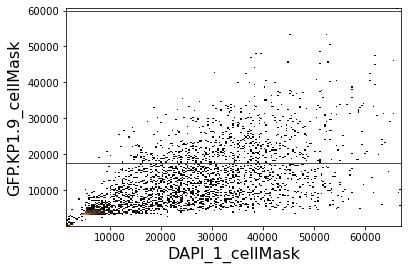

In [96]:
sample.plot(['DAPI_1_cellMask', 'GFP.KP1.9_cellMask'], gates=[gfp_neg_gate, gfp_pos_gate]);

In [97]:
def altair_sample_plot(samples, axes, gates, titles, title, sample_ids):
    df = pd.DataFrame()
    for sample_id, sample in zip(sample_ids, samples):
        sample_df = sample.get_data()
        sample_df["sample_id"] = sample_id
        df = df.append(sample_df, ignore_index=True)
    
    df = df.rename(
        columns=dict(zip(
            df.columns.values.tolist(),
            [col.replace(".", "_") for col in df.columns.values.tolist()]
        ))
    )
    
    plot = alt.Chart(df).mark_circle(opacity=0.1).encode(
        x=alt.X(f"{axes[0]}:Q", axis=alt.Axis(title=titles[0])),
        y=alt.Y(f"{axes[1]}:Q", axis=alt.Axis(title=titles[1])),
        color=alt.Color("sample_id:N", legend=alt.Legend(title="Image", symbolOpacity=1.0))
    ).properties(
        title=title
    )
    
    if gates[0] is not None:
        rule_x = alt.Chart(pd.DataFrame({'x': [gates[0].vert[1]]})).mark_rule().encode(x='x')
    if gates[1] is not None:
        rule_y = alt.Chart(pd.DataFrame({'y': [gates[1].vert[1]]})).mark_rule().encode(y='y')
    
    result = plot
    
    if gates[0] is not None:
        result += rule_x
    if gates[1] is not None:
        result += rule_y
    
    return result

In [105]:
altair_sample_plot(samples, ['DAPI_1_cellMask', 'GFP_KP1_9_cellMask'], [None, gfp_neg_gate], ["DAPI", "GFP"], "GFP+ Tumor vs. GFP- Host", SAMPLE_IDS)

alt.LayerChart(...)

In [106]:
altair_sample_plot(samples, ['DAPI_2_cellMask', 'GFP_KP1_9_cellMask'], [None, gfp_neg_gate], ["DAPI", "GFP"], "GFP+ Tumor vs. GFP- Host", SAMPLE_IDS)

alt.LayerChart(...)

In [107]:
def mask_sample_plot(samples, channel, in_gate, sample_ids):
    
    results = []
    
    for sample_id, sample in zip(sample_ids, samples):
        image = imread(join("data", sample_id, "segmentation", f"unmicst-{sample_id}", "cellMask.tif"))
        colors = [
            [57, 119, 175],
            [239, 133, 54],
            [81, 157, 62],
            [197, 57, 50],
            [141, 107, 184],
            [133, 88, 78],
            [227, 119, 194],
            [188, 189, 34]
        ]
        rgb_image = np.zeros((*image.shape, 3))
        int_image = np.zeros((*image.shape, ))

        gated_in_sample = sample.gate(in_gate)
        gated_in_sample_df = gated_in_sample.get_data()
        gated_in_cell_ids = [ (int(i)+1) for i in gated_in_sample_df.index.values.tolist() ]

        for cell_id in gated_in_cell_ids:
            rgb_image[image == cell_id] = colors[0]
            int_image[image == cell_id] = 1
        
        os.makedirs(join("data", sample_id, "masks"), exist_ok=True)
        imwrite(join("data", sample_id, "masks", f"{channel}.tif"), rgb_image, photometric='rgb')
        
        results.append(int_image)
    
    # TODO: return results for all samples
    return int_image

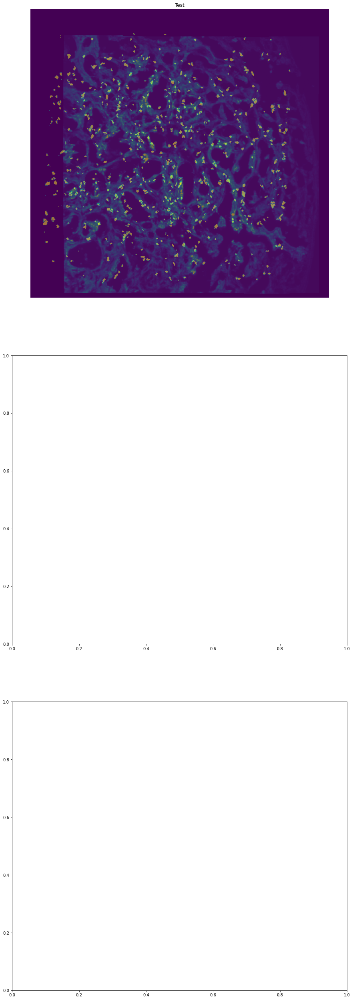

In [114]:
image = imread(join("data", "lung_2_2", "pre-raw", f"lung_2_2-cycle-01-channel-02.tif"))

rgb_image = mask_sample_plot(samples, 'GFP_KP1_9_cellMask', gfp_pos_gate, SAMPLE_IDS)

fig, ax = plt.subplots(3, 1, figsize=(15,15*3))
ax[0].imshow(image)
ax[0].imshow(rgb_image, alpha=0.5)
ax[0].title.set_text("Test")
ax[0].axis('off');

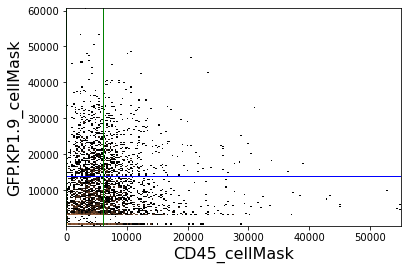

In [132]:
sample.plot(['CD45_cellMask', 'GFP.KP1.9_cellMask'], gates=[gfp_neg_gate, gfp_neg_cd45_neg_gate]);

In [133]:
altair_sample_plot(samples, ['CD45_cellMask', 'GFP_KP1_9_cellMask'], [gfp_neg_cd45_neg_gate, gfp_neg_gate], ["CD45", "GFP"], "CD45", SAMPLE_IDS)

alt.LayerChart(...)

In [134]:
altair_sample_plot(samples, ['CD11c_cellMask', 'GFP_KP1_9_cellMask'], [gfp_neg_cd11c_neg_gate, gfp_neg_gate], ["CD11c", "GFP"], "CD11c", SAMPLE_IDS)

alt.LayerChart(...)

In [135]:
gfp_neg_cd45_pos_gate.vert

(6000, 60000)

In [136]:
gfp_pos_gated_sample = sample.gate(gfp_pos_gate)
gfp_neg_gated_sample = sample.gate(gfp_neg_gate)

In [137]:
gfp_neg_gated_sample.counts

2372

In [62]:
altair_sample_plot(gfp_neg_gated_sample, ['CD11c_cellMask', 'CD45_cellMask'], [gfp_neg_cd11c_neg_gate, gfp_neg_cd45_neg_gate], ["CD11c", "CD45"], "CD45, CD11c within GFP-")

TypeError: altair_sample_plot() missing 1 required positional argument: 'sample_ids'

In [63]:
altair_sample_plot(gfp_pos_gated_sample, ['CD11c_cellMask', 'CD45_cellMask'], [gfp_neg_cd11c_neg_gate, gfp_neg_cd45_neg_gate], ["CD11c", "CD45"], "CD45, CD11c within GFP+")

TypeError: altair_sample_plot() missing 1 required positional argument: 'sample_ids'

## GFP- Host

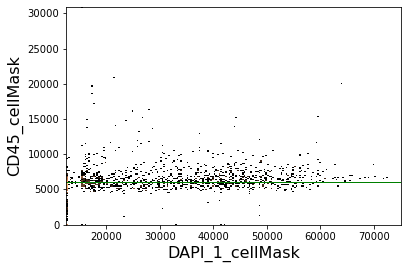

In [71]:
gfp_neg_gated_sample.plot(['DAPI_1_cellMask', 'CD45_cellMask'], gates=[gfp_neg_cd45_neg_gate, gfp_neg_cd45_pos_gate]);

In [72]:
gfp_neg_cd45_neg_gated_sample = gfp_neg_gated_sample.gate(gfp_neg_cd45_neg_gate)
gfp_neg_cd45_pos_gated_sample = gfp_neg_gated_sample.gate(gfp_neg_cd45_pos_gate)

In [73]:
gfp_neg_cd45_neg_gated_sample.counts

676

In [74]:
gfp_neg_cd45_pos_gated_sample.counts

804

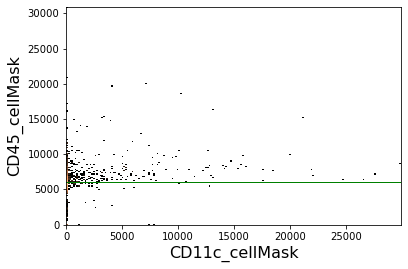

In [75]:
gfp_neg_gated_sample.plot(['CD11c_cellMask', 'CD45_cellMask'], gates=[gfp_neg_cd45_neg_gate, gfp_neg_cd45_pos_gate]);

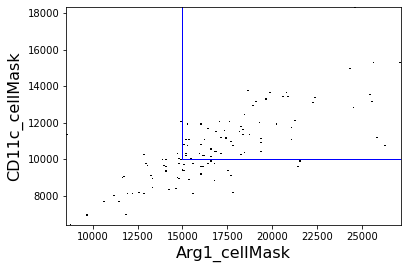

In [85]:
gfp_neg_cd45_pos_cd206_pos_gated_sample.plot(['Arg1_cellMask', 'CD11c_cellMask'], gates=[gfp_neg_cd45_pos_cd206_pos_cd11c_pos_arg1_pos_gate]);

In [86]:
gfp_neg_cd45_pos_cd206_pos_cd11c_pos_arg1_pos_gated_sample = gfp_neg_cd45_pos_cd206_pos_gated_sample.gate(gfp_neg_cd45_pos_cd206_pos_cd11c_pos_arg1_pos_gate)

In [87]:
gfp_neg_cd45_pos_cd206_pos_cd11c_pos_arg1_pos_gated_sample.counts

63

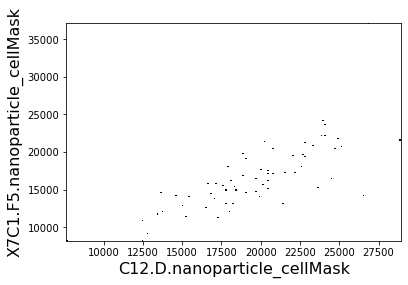

In [88]:
gfp_neg_cd45_pos_cd206_pos_cd11c_pos_arg1_pos_gated_sample.plot(['C12.D.nanoparticle_cellMask', 'X7C1.F5.nanoparticle_cellMask']);

## GFP+ Tumor

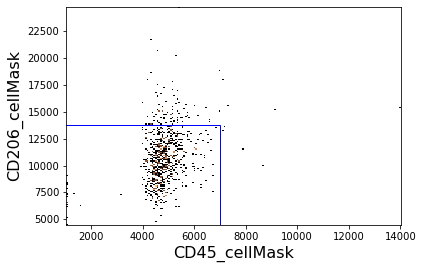

In [89]:
gfp_pos_gated_sample.plot(['CD45_cellMask', 'CD206_cellMask'], gates=[gfp_pos_cd45_neg_cd206_neg_gate]);

In [90]:
gfp_pos_cd45_neg_cd206_neg_gated_sample = gfp_pos_gated_sample.gate(gfp_pos_cd45_neg_cd206_neg_gate)

In [91]:
gfp_pos_cd45_neg_cd206_neg_gated_sample.counts

738

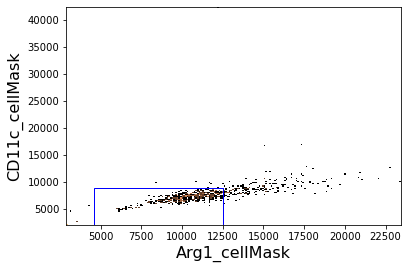

In [92]:
gfp_pos_cd45_neg_cd206_neg_gated_sample.plot(['Arg1_cellMask', 'CD11c_cellMask'], gates=[gfp_pos_cd45_neg_cd206_neg_cd11c_neg_arg1_neg_gate]);

In [93]:
gfp_pos_cd45_neg_cd206_neg_cd11c_neg_arg1_neg_gated_sample = gfp_pos_cd45_neg_cd206_neg_gated_sample.gate(gfp_pos_cd45_neg_cd206_neg_cd11c_neg_arg1_neg_gate)

In [30]:
gfp_pos_cd45_neg_cd206_neg_cd11c_neg_arg1_neg_gated_sample.counts

519

In [27]:
def classify_cells(sample, class_to_df):
    df = pd.DataFrame(index=sample.get_data().index.values.tolist(), columns=[], data=[])
    for cell_class_name, cell_class_sample in class_to_df.items():
        cells = cell_class_sample.get_data().index.values.tolist()
        df[cell_class_name] = df.index.to_series().apply(lambda i: i in cells)
    
    return df

In [28]:
df = classify_cells(sample, {
    "GFP-": gfp_neg_gated_sample,
    "GFP-/CD45+CD206+": gfp_neg_cd45_pos_cd206_pos_gated_sample,
    "GFP-/CD45+CD206+/CD11c+Arg1+": gfp_neg_cd45_pos_cd206_pos_cd11c_pos_arg1_pos_gated_sample,
    "GFP+": gfp_pos_gated_sample,
    "GFP+/CD45-CD206-": gfp_pos_cd45_neg_cd206_neg_gated_sample,
    "GFP+/CD45-CD206-/CD11c-Arg1-": gfp_pos_cd45_neg_cd206_neg_cd11c_neg_arg1_neg_gated_sample,
})

df.to_csv(join("data", sample_id, "flowcore", f"{sample_id}.classes.csv"), index=True)

In [29]:
writer = pd.ExcelWriter(join("data", sample_id, "flowcore", f"{sample_id}.classes.xlsx"))

for col in df.columns.values.tolist():
    sample.get_data().loc[df[col]].to_excel(writer, sheet_name=col.replace("/", " "))

writer.save()